In [26]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import statsmodels.stats.diagnostic
from sklearn import svm, linear_model
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from pyecharts import options as opts
from pyecharts.charts import Scatter3D
import random

# import data from CSV file

In [27]:
df = pd.read_csv('CpmDataExport_DeviceNumber_17_RAWMergeTime_2019-09-23_03_14_36.CSV', sep=',',skiprows=10)

In [28]:
columns = [column for column in df]
columns

['Time',
 'L1',
 'L2',
 'L3',
 'Environment',
 'OutgoingL1_1',
 'OutgoingL2_1',
 'OutgoingL3_1',
 'OutgoingL1_2',
 'OutgoingL2_2',
 'OutgoingL3_2']

In [29]:
EnvironmentDataList = df.Environment.value_counts()
EnvironmentDataList

43.0    150
42.0    143
44.0    115
45.0     79
46.0     65
47.0     59
48.0     42
49.0     17
Name: Environment, dtype: int64

In [30]:
df.head(10)

,Time,L1,L2,L3,Environment,OutgoingL1_1,OutgoingL2_1,OutgoingL3_1,OutgoingL1_2,OutgoingL2_2,OutgoingL3_2
0,2019-09-15 23-53-10,0.9575,NaN,NaN,NaN,NaN,NaN,NaN,NaN,38.0,NaN
1,2019-09-15 23-53-12,NaN,0.0,0.0,NaN,NaN,38.0,NaN,38.0,NaN,38.0
2,2019-09-15 23-55-00,NaN,NaN,NaN,NaN,38.0,NaN,NaN,NaN,NaN,NaN
3,2019-09-15 23-56-10,NaN,NaN,NaN,NaN,NaN,NaN,38.0,NaN,NaN,NaN
4,2019-09-16 00-03-10,NaN,NaN,NaN,NaN,NaN,NaN,38.0,NaN,38.0,NaN
5,2019-09-16 00-03-12,0.9575,0.0,0.0,NaN,38.0,38.0,NaN,38.0,NaN,38.0
6,2019-09-16 00-04-50,NaN,NaN,NaN,NaN,NaN,NaN,38.0,NaN,NaN,NaN
7,2019-09-16 00-04-52,NaN,NaN,NaN,NaN,NaN,NaN,37.0,NaN,NaN,NaN
8,2019-09-16 00-04-56,NaN,NaN,NaN,NaN,NaN,NaN,38.0,NaN,NaN,NaN
9,2019-09-16 00-12-08,NaN,NaN,NaN,NaN,38.0,NaN,NaN,NaN,NaN,NaN


In [31]:
df.describe()

,L1,L2,L3,Environment,OutgoingL1_1,OutgoingL2_1,OutgoingL3_1,OutgoingL1_2,OutgoingL2_2,OutgoingL3_2
count,53028.000000,52906.000000,53411.000000,670.000000,21911.000000,21414.000000,23488.000000,23931.000000,19975.000000,19573.000000
mean,177.202734,187.982630,185.652503,44.302985,45.028707,45.858644,44.829147,44.752998,44.269086,43.506718
std,59.069724,56.007911,58.964637,1.981791,55.064246,55.752954,53.241992,52.754165,57.587224,58.123794
min,0.000000,0.000000,0.000000,42.000000,35.000000,35.000000,35.000000,35.000000,35.000000,35.000000
25%,151.285000,156.072500,156.790625,43.000000,38.000000,38.000000,37.000000,37.000000,37.000000,37.000000
50%,211.607500,219.746250,219.506875,44.000000,44.000000,45.000000,44.000000,44.000000,44.000000,43.000000
75%,214.240625,222.379375,222.379375,46.000000,50.000000,52.000000,51.000000,51.000000,49.000000,47.000000
max,321.480625,332.013125,332.731250,49.000000,4095.000000,4095.000000,4095.000000,4095.000000,4095.000000,4095.000000


# Pre-processing Data

In [32]:
df.fillna(method='bfill',axis=0, inplace = True)

In [33]:
# df.fillna(method='pad',axis=0, inplace = True)
df.dropna(how='any',axis=0,inplace=True)
df = df[df['OutgoingL1_1']<=1000]

In [34]:
df.head(10)

,Time,L1,L2,L3,Environment,OutgoingL1_1,OutgoingL2_1,OutgoingL3_1,OutgoingL1_2,OutgoingL2_2,OutgoingL3_2
0,2019-09-15 23-53-10,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
1,2019-09-15 23-53-12,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
2,2019-09-15 23-55-00,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
3,2019-09-15 23-56-10,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
4,2019-09-16 00-03-10,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
5,2019-09-16 00-03-12,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
6,2019-09-16 00-04-50,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
7,2019-09-16 00-04-52,0.9575,0.0,0.0,47.0,38.0,38.0,37.0,38.0,38.0,38.0
8,2019-09-16 00-04-56,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
9,2019-09-16 00-12-08,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0


# Data Visualization

## 3D

In [35]:
def scatter3d_base(LabelX, LabelY, LabelZ, DataX, DataY, DataZ,len) -> Scatter3D:
    data = [
            [DataX[i], DataY[i], DataZ[i]] for i in range(len)
    ]
    c = (
        Scatter3D()
        .add("Temp", data,
                xaxis3d_opts=opts.Axis3DOpts(name=LabelX, type_="value",min_=38),
                yaxis3d_opts=opts.Axis3DOpts(name=LabelY, type_="value"),
                zaxis3d_opts=opts.Axis3DOpts(name=LabelZ, type_="value")
            )
        .set_global_opts(
            title_opts=opts.TitleOpts("Temp"),
            visualmap_opts=opts.VisualMapOpts(),
        )
    )
    return c

In [36]:
# fig = plt.figure(figsize=(16, 12))
# ax = fig.add_subplot(111, projection='3d')
# ax.scatter(df['L1'],df['Environment'],df['OutgoingL1_1'])
# ax.set_xlabel('L1')
# ax.set_ylabel('Environment')
# ax.set_zlabel('OutgoingL1_1')
# ax.scatter(df['L1'],df['OutgoingL1_1'])
# plt.show()
sca= scatter3d_base("Environment", "Current L1", "Sensor Temperature", df['Environment'].tolist(), df['L1'].tolist(), df['OutgoingL1_1'].tolist(), df.shape[0])
sca.render_notebook()

## 2D

### Display the relation of Current and Sensor Temperature under same Environment

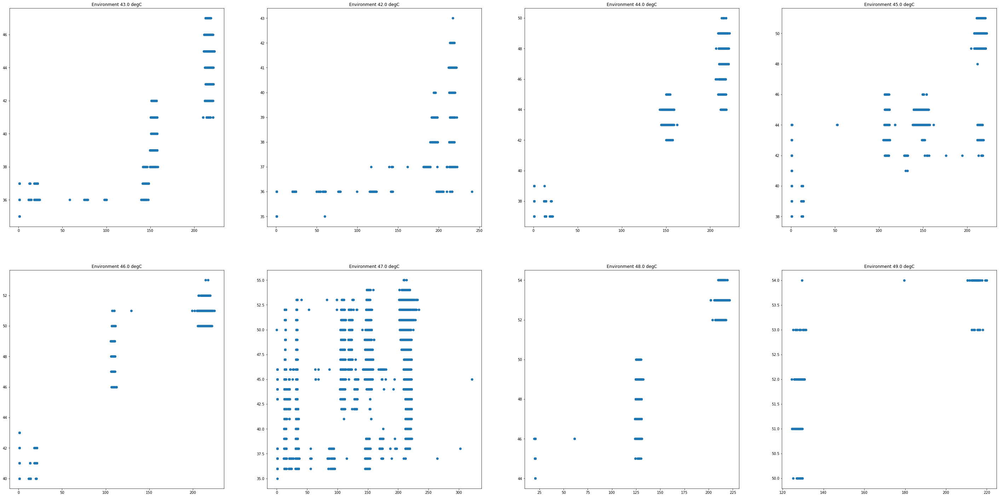

In [37]:
f, ax = plt.subplots(2, 4, figsize = (50, 25))
pltRow=0
pltCol=0
for env in EnvironmentDataList.to_dict().keys():
    dfE = df[["L1", "OutgoingL1_1"]][df.Environment==int(env)]
    ax[pltRow, pltCol].scatter(dfE["L1"], dfE["OutgoingL1_1"])
    ax[pltRow, pltCol].set_title("Environment " + str(env) + " degC")
    if pltCol == 3:
        pltCol = 0
        pltRow += 1
    else:
        pltCol += 1

### L1 - Environment - SensorTemperature

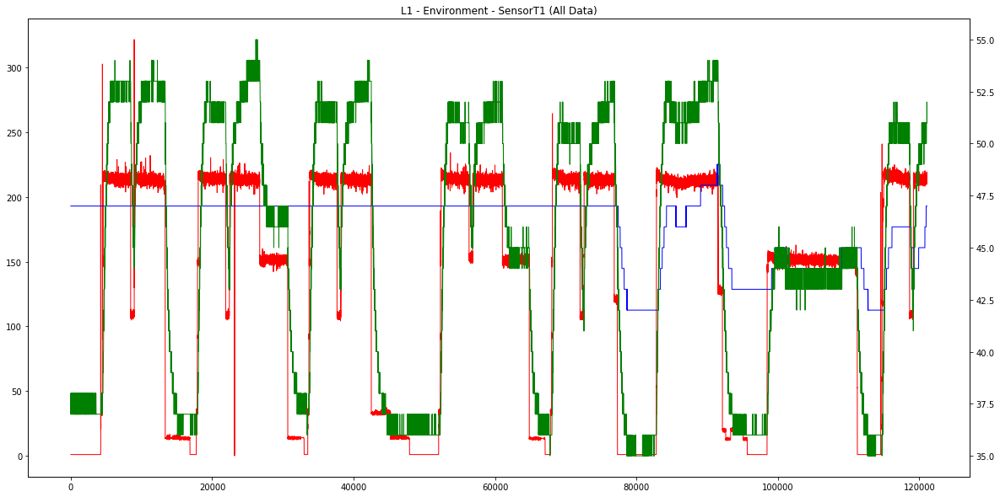

In [38]:
plt.figure(figsize=(20,10))
x = [x for x in range(len(df))]
plt.plot(x, df.L1,color="red", linewidth=1, label = 'L1')
plt.title('L1 - Environment - SensorT1 (All Data)')
plt.twinx()
plt.plot(x, df.Environment, color="blue", linewidth=1, label = 'Environment')
plt.plot(x, df.OutgoingL1_1, color="green", linewidth=1, label = 'T1')

The environment value is not available in the first 80000 points.

In [39]:
dfp = df.tail(40000)

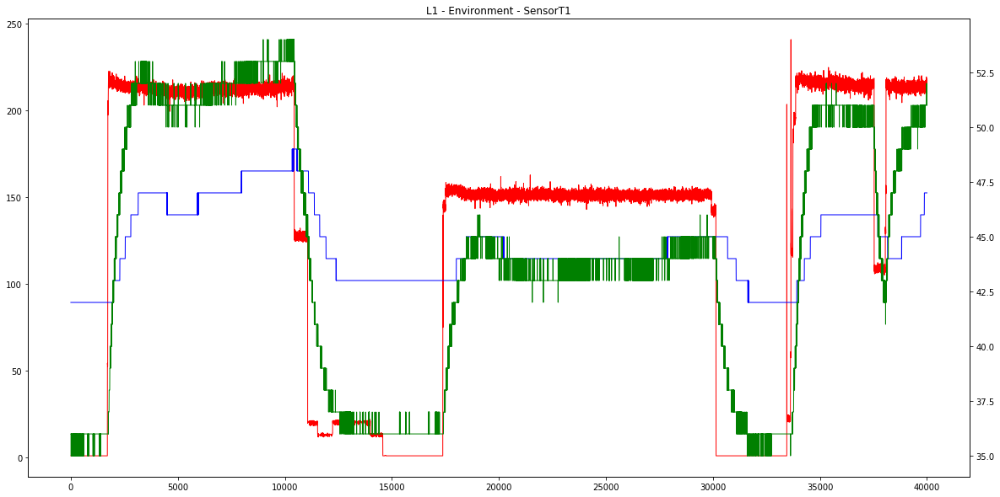

In [40]:
plt.figure(figsize=(20,10))
x = [x for x in range(len(dfp))]
plt.plot(x, dfp.L1,color="red",linewidth=1)
plt.title('L1 - Environment - SensorT1')
plt.twinx()
plt.plot(x, dfp.Environment, color="blue", linewidth = 1)
plt.plot(x, dfp.OutgoingL1_1, color="green", linewidth = 1)

### L2 - Environment - SensorTemperature

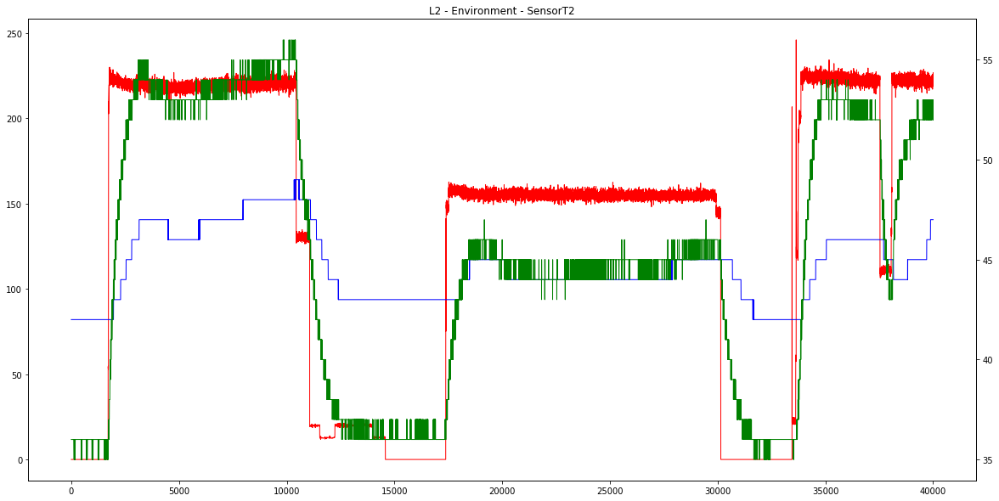

In [41]:
plt.figure(figsize=(20,10))
x = [x for x in range(len(dfp))]
plt.plot(x, dfp.L2,color="red",linewidth=1)
plt.title('L2 - Environment - SensorT2')
plt.twinx()
plt.plot(x, dfp.Environment, color="blue", linewidth = 1)
plt.plot(x, dfp.OutgoingL2_1, color="green", linewidth = 1)

### L3 - Environment - SensorTemperature

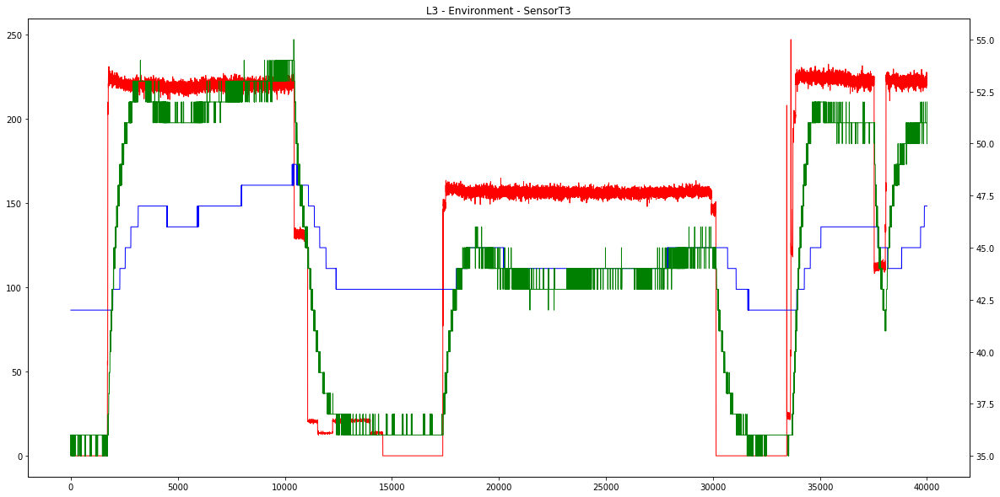

In [42]:
plt.figure(figsize=(20,10))
x = [x for x in range(len(dfp))]
plt.plot(x, dfp.L3,color="red",linewidth=1)
plt.title('L3 - Environment - SensorT3')
plt.twinx()
plt.plot(x, dfp.Environment, color="blue", linewidth = 1)
plt.plot(x, dfp.OutgoingL3_1, color="green", linewidth = 1)

# BBR

## Prepare training data

In [155]:
AllDataCount = len(df)
AllDataCount

121101

In [156]:
data_trainRaw = df[["L1", "Environment", "OutgoingL1_1"]].head(int(AllDataCount*0.8))
data_testRaw = df[["L1", "Environment", "OutgoingL1_1"]].tail(int(AllDataCount*0.2))

In [157]:
data_trainRaw.reindex()
data_testRaw.reindex()
WindowsSize = 5
#data_trainRaw = data_trainRaw.tail(10000)
print(len(data_trainRaw), len(data_testRaw))

96880 24220


In [158]:
data_train = pd.DataFrame()
for i in range(0, len(data_trainRaw)-WindowsSize + 1, 1):
    for j in range(0, WindowsSize, 1):
        data_train.loc[i, j] = data_trainRaw.iloc[i+j, 0]
    data_train.loc[i, WindowsSize + 1] = data_trainRaw.iloc[i, 1]
    data_train.loc[i, WindowsSize + 2] = data_trainRaw.iloc[i, 2]
data_train

,0,1,2,3,4,6,7
0,0.9575,0.9575,0.9575,0.9575,0.9575,47.0,38.0
1,0.9575,0.9575,0.9575,0.9575,0.9575,47.0,38.0
2,0.9575,0.9575,0.9575,0.9575,0.9575,47.0,38.0
3,0.9575,0.9575,0.9575,0.9575,0.9575,47.0,38.0
4,0.9575,0.9575,0.9575,0.9575,0.9575,47.0,38.0
5,0.9575,0.9575,0.9575,0.9575,0.9575,47.0,38.0
6,0.9575,0.9575,0.9575,0.9575,0.9575,47.0,38.0
7,0.9575,0.9575,0.9575,0.9575,0.9575,47.0,38.0
8,0.9575,0.9575,0.9575,0.9575,0.9575,47.0,38.0
9,0.9575,0.9575,0.9575,0.9575,0.9575,47.0,38.0


## Traing model

In [159]:
clf = linear_model.Ridge()
data_train_x = data_train.loc[:,0:6]
data_train_y = data_train.loc[:,7]

In [160]:
clf.fit(data_train_x,data_train_y)
print(clf.coef_)
print(clf.intercept_)

[ 0.05478051  0.02116942  0.00737138 -0.00294063 -0.01662154  0.5038912 ]
13.646519909255115


### Verify train data

In [173]:
predictY = clf.predict(data_train_x)
predictY_H = predictY * (1 + 0.0325)
predictY_L = predictY * (1 - 0.0325)

d:\python3.7\lib\site-packages\IPython\core\pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


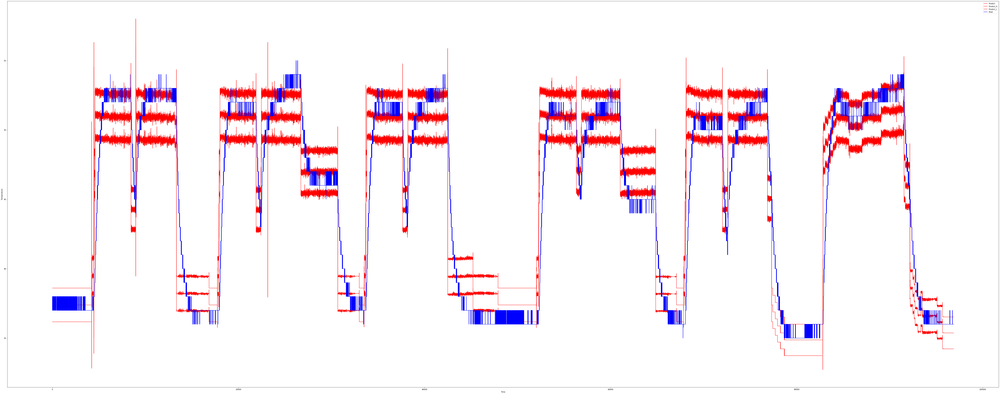

In [182]:
plt.figure(figsize=(100, 40))
plt.plot(data_train_x.index,predictY, color='red', label='Predict')
plt.plot(data_train_x.index,predictY_H, color='red', label='Predict_H')
plt.plot(data_train_x.index,predictY_L, color='red', label='Predict_L')
plt.plot(data_train_x.index,data_train_y, color='blue', label='Real')

plt.legend()
plt.xlabel('Time')
plt.ylabel('Temperature')
plt.show()

### Verify test data